# MaskRCNN Glomeruli Detection

In [1]:
import os
import sys
import random
import math
import re
import time
import numpy as np
import cv2
import matplotlib
import matplotlib.pyplot as plt
import json
from skimage.io import imread, imshow, imread_collection, concatenate_images
from skimage.transform import resize
from tqdm import tqdm


# Root directory of the project
ROOT_DIR = os.path.abspath("../")

# Import Mask RCNN
sys.path.append(ROOT_DIR)  # To find local version of the library
from mrcnn.config import Config
from mrcnn import utils
import mrcnn.model as modellib
from mrcnn import visualize
from mrcnn.model import log

%matplotlib inline 

# Directory to save logs and trained model
MODEL_DIR = os.path.join(ROOT_DIR, "logs")
# MODEL_DIR="C:/Users/jashj/Desktop/Github mask rcnn/Mask_RCNN/MaskRCNN-Object-Detection-and-Segmentation-master/weights_20_5/mask_rcnn_glomeruli_0004.h5"

# Local path to trained weights file
# COCO_MODEL_PATH = os.path.join(ROOT_DIR, "mask_rcnn_coco.h5")
# COCO_MODEL_PATH="C:/Users/jashj/Desktop/Github mask rcnn/Mask_RCNN/MaskRCNN-Object-Detection-and-Segmentation-master/weights_20_5/mask_rcnn_glomeruli_0004.h5"
# Download COCO trained weights from Releases if needed
# if not os.path.exists(COCO_MODEL_PATH):
#     utils.download_trained_weights(COCO_MODEL_PATH)

Using TensorFlow backend.


## Configurations

In [2]:
class GlomeruliConfig(Config):
    # Give the configuration a recognizable name
    NAME = "Glomeruli_segmentation"
    
    NUM_CLASSES = 1 + 1

    GPU_COUNT = 1
    IMAGES_PER_GPU = 1

config = GlomeruliConfig()
config.display()


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.7
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                14
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE         

## Dataset

In [4]:
from PIL import Image
Image.MAX_IMAGE_PIXELS = 1000000000
Image.warnings.simplefilter('error', Image.DecompressionBombWarning)

In [5]:
#Folder containing the files for testing
# PATH='C:/Users/jashj/Desktop/images/29 Friday'
PATH="C:/Users/jashj/Desktop/RA/Human Annotation Analysis using QuPath/Segments_1800x1800_v1j_resize_overlap"

# Glomeruli

In [6]:
class GlomeruliDataset(utils.Dataset):
    def load_dataset(self, dataset_dir):
        self.add_class('dataset', 1, 'Glomeruli')

        
        # find all images
        for i, filename in enumerate(os.listdir(dataset_dir)):
            if '.jpg' in filename:
                self.add_image('dataset', 
                               image_id=i, 
                               path=os.path.join(dataset_dir, filename), 
                               annotation=os.path.join(dataset_dir, filename.replace('.jpg', '.json')))
    
    def extract_masks(self, filename):
        json_file = os.path.join(filename)
        with open(json_file) as f:
            img_anns = json.load(f)
            
        masks = np.zeros([600, 800, len(img_anns['shapes'])], dtype='uint8')
        classes = []
        for i, anno in enumerate(img_anns['shapes']):
            mask = np.zeros([600, 800], dtype=np.uint8)
            cv2.fillPoly(mask, np.array([anno['points']], dtype=np.int32), 1)
            masks[:, :, i] = mask
            classes.append(self.class_names.index(anno['label']))
        return masks, classes
 
    # load the masks for an image
    def load_mask(self, image_id):
        # get details of image
        info = self.image_info[image_id]
        # define box file location
        path = info['annotation']
        # load XML
        masks, classes = self.extract_masks(path)
        return masks, np.asarray(classes, dtype='int32')
    
    def image_reference(self, image_id):
        info = self.image_info[image_id]
        return info['path']

In [7]:
# Create training and validation set
# train set
dataset_train = GlomeruliDataset()
dataset_train.load_dataset('images/train')
dataset_train.prepare()
print('Train: %d' % len(dataset_train.image_ids))
 
# test/val set
dataset_val = GlomeruliDataset()
dataset_val.load_dataset(PATH)
dataset_val.prepare()
print('Test: %d' % len(dataset_val.image_ids))

Train: 77
Test: 609


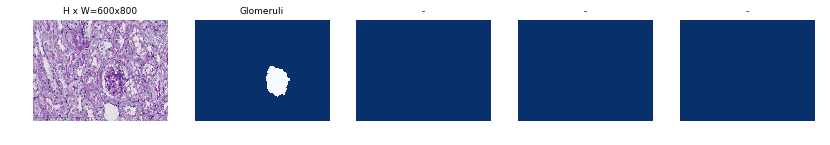

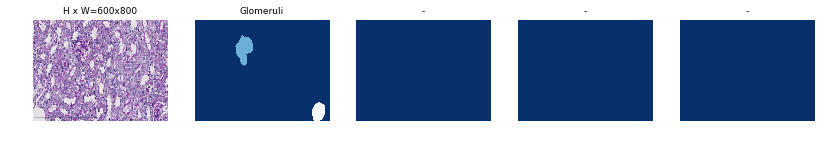

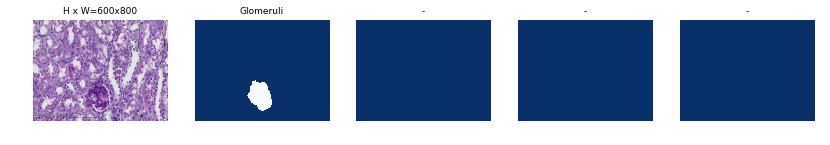

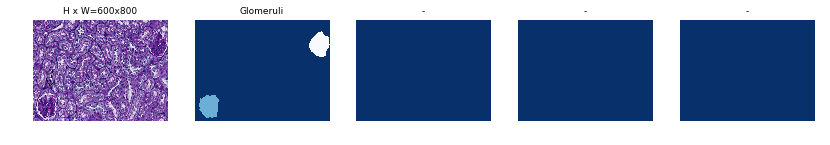

In [8]:
# Load and display random samples
image_ids = np.random.choice(dataset_train.image_ids, 4)
for image_id in image_ids:
    image = dataset_train.load_image(image_id)
    mask, class_ids = dataset_train.load_mask(image_id)
    visualize.display_top_masks(image, mask, class_ids, dataset_train.class_names)

## Detection

In [9]:
class InferenceConfig(GlomeruliConfig):
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1

inference_config = InferenceConfig()

# Recreate the model in inference mode
model = modellib.MaskRCNN(mode="inference", 
                          config=inference_config,
                          model_dir=MODEL_DIR)

# Get path to saved weights
# Either set a specific path or find last trained weights
# model_path = os.path.join(ROOT_DIR, ".h5 file name here")
# model_path = model.find_last()
model_path="C:/Users/jashj/Desktop/Github mask rcnn/Mask_RCNN/MaskRCNN-Object-Detection-and-Segmentation-master/latest weights/mask_rcnn_glomeruli_0006.h5"
# Load trained weights
print("Loading weights from ", model_path)
model.load_weights(model_path, by_name=True)

Instructions for updating:
If using Keras pass *_constraint arguments to layers.


Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
Instructions for updating:
box_ind is deprecated, use box_indices instead


Instructions for updating:
Use `tf.cast` instead.
Loading weights from  C:/Users/jashj/Desktop/Github mask rcnn/Mask_RCNN/MaskRCNN-Object-Detection-and-Segmentation-master/latest weights/mask_rcnn_glomeruli_0006.h5


In [10]:
def get_ax(rows=1, cols=1, size=8):
    """Return a Matplotlib Axes array to be used in
    all visualizations in the notebook. Provide a
    central point to control graph sizes.
    
    Change the default size attribute to control the size
    of rendered images
    """
    _, ax = plt.subplots(rows, cols, figsize=(size*cols, size*rows))
    return ax

In [11]:
file_reference_id_name=[]
for i, filename in enumerate(os.listdir(PATH)):
#     print(i,filename)
    file_reference_id_name.append((i,filename))

In [12]:
file_reference_id_name

[(0, '0.jpg'),
 (1, '1.jpg'),
 (2, '10.jpg'),
 (3, '100.jpg'),
 (4, '101.jpg'),
 (5, '102.jpg'),
 (6, '103.jpg'),
 (7, '104.jpg'),
 (8, '105.jpg'),
 (9, '106.jpg'),
 (10, '107.jpg'),
 (11, '108.jpg'),
 (12, '109.jpg'),
 (13, '11.jpg'),
 (14, '110.jpg'),
 (15, '111.jpg'),
 (16, '112.jpg'),
 (17, '113.jpg'),
 (18, '114.jpg'),
 (19, '115.jpg'),
 (20, '116.jpg'),
 (21, '117.jpg'),
 (22, '118.jpg'),
 (23, '119.jpg'),
 (24, '12.jpg'),
 (25, '120.jpg'),
 (26, '121.jpg'),
 (27, '122.jpg'),
 (28, '123.jpg'),
 (29, '124.jpg'),
 (30, '125.jpg'),
 (31, '126.jpg'),
 (32, '127.jpg'),
 (33, '128.jpg'),
 (34, '129.jpg'),
 (35, '13.jpg'),
 (36, '130.jpg'),
 (37, '131.jpg'),
 (38, '132.jpg'),
 (39, '133.jpg'),
 (40, '134.jpg'),
 (41, '135.jpg'),
 (42, '136.jpg'),
 (43, '137.jpg'),
 (44, '138.jpg'),
 (45, '139.jpg'),
 (46, '14.jpg'),
 (47, '140.jpg'),
 (48, '141.jpg'),
 (49, '142.jpg'),
 (50, '143.jpg'),
 (51, '144.jpg'),
 (52, '145.jpg'),
 (53, '146.jpg'),
 (54, '147.jpg'),
 (55, '148.jpg'),
 (56, '149.

In [13]:
dataset_val.image_ids

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
       156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
       169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 18

In [27]:
# Test on a random image
image_id = random.choice(dataset_val.image_ids)
# image_id = 55
image_id

600

In [28]:
original_image, image_meta =\
    modellib.load_image_gt2(dataset_val, inference_config, 
                           image_id)

log("original_image", original_image)
log("image_meta", image_meta)
# log("gt_class_id", gt_class_id)
# log("gt_bbox", gt_bbox)
# log("gt_mask", gt_mask)

# visualize.display_instances(original_image, gt_bbox, gt_mask, gt_class_id, 
#                             dataset_train.class_names, figsize=(8, 8))

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64


Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


array([[[148,  81, 161],
        [146,  80, 160],
        [143,  76, 155],
        ...,
        [ 91,  29, 115],
        [ 92,  23, 112],
        [106,  34, 123]],

       [[126,  64, 143],
        [140,  77, 156],
        [158,  94, 172],
        ...,
        [ 95,  29, 119],
        [ 93,  25, 115],
        [109,  39, 128]],

       [[ 93,  37, 116],
        [108,  50, 129],
        [161, 100, 177],
        ...,
        [108,  38, 129],
        [109,  40, 131],
        [110,  41, 130]],

       ...,

       [[ 78,  22, 110],
        [ 83,  25, 112],
        [112,  50, 136],
        ...,
        [152,  97, 164],
        [138,  87, 147],
        [196, 152, 201]],

       [[ 95,  35, 121],
        [120,  58, 144],
        [136,  68, 157],
        ...,
        [157, 102, 169],
        [143,  92, 152],
        [201, 155, 204]],

       [[139,  78, 161],
        [130,  64, 151],
        [129,  55, 145],
        ...,
        [146,  93, 159],
        [173, 122, 181],
        [212, 165, 214]]

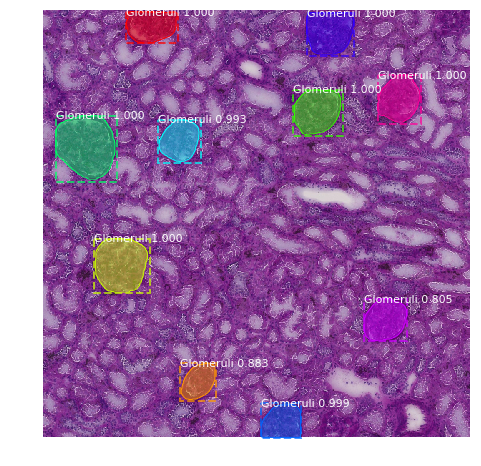

In [29]:
results = model.detect([original_image], verbose=1)

r = results[0]
visualize.display_instances(original_image, r['rois'], r['masks'], r['class_ids'], 
                            dataset_val.class_names, r['scores'], ax=get_ax(),score_threshold=0.5)

# Counting and saving

In [ ]:
# Masks = np.zeros((resize_height*resize_width, 1024, 1024))

  0%|                                                                                          | 0/609 [00:00<?, ?it/s]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: -103.90000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  0%|▏                                                                                 | 1/609 [00:03<33:57,  3.35s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  226.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  226.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  122.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  0%|▎                                                                                 | 2/609 [00:06<34:29,  3.41s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  147.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  0%|▍                                                                                 | 3/609 [00:10<34:44,  3.44s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  145.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  1%|▌                                                                                 | 4/609 [00:14<35:15,  3.50s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  146.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  1%|▋                                                                                 | 5/609 [00:17<35:26,  3.52s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  144.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  1%|▊                                                                                 | 6/609 [00:21<35:17,  3.51s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  131.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  1%|▉                                                                                 | 7/609 [00:24<35:15,  3.51s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  1%|█                                                                                 | 8/609 [00:28<35:03,  3.50s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  1%|█▏                                                                                | 9/609 [00:31<35:02,  3.50s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  2%|█▎                                                                               | 10/609 [00:35<34:46,  3.48s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  2%|█▍                                                                               | 11/609 [00:38<34:46,  3.49s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  2%|█▌                                                                               | 12/609 [00:42<34:54,  3.51s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  2%|█▋                                                                               | 13/609 [00:45<34:43,  3.50s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  146.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  2%|█▊                                                                               | 14/609 [00:49<34:53,  3.52s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  2%|█▉                                                                               | 15/609 [00:52<34:46,  3.51s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  3%|██▏                                                                              | 16/609 [00:56<34:43,  3.51s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  3%|██▎                                                                              | 17/609 [00:59<34:32,  3.50s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    7.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    7.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -109.80000  max:  137.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  3%|██▍                                                                              | 18/609 [01:03<34:25,  3.49s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   12.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   12.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -104.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  3%|██▌                                                                              | 19/609 [01:06<34:14,  3.48s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   13.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   13.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -103.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  3%|██▋                                                                              | 20/609 [01:10<34:06,  3.47s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: -103.90000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


C:\Users\jashj\AppData\Local\Continuum\anaconda3\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
  3%|██▊                                                                              | 21/609 [01:13<34:01,  3.47s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  220.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  220.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  115.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  4%|██▉                                                                              | 22/609 [01:16<34:02,  3.48s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  4%|███                                                                              | 23/609 [01:20<34:31,  3.54s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  147.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  4%|███▏                                                                             | 24/609 [01:24<35:28,  3.64s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  4%|███▎                                                                             | 25/609 [01:28<35:25,  3.64s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  4%|███▍                                                                             | 26/609 [01:32<36:04,  3.71s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  4%|███▌                                                                             | 27/609 [01:35<36:17,  3.74s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  5%|███▋                                                                             | 28/609 [01:39<36:52,  3.81s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  147.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  5%|███▊                                                                             | 29/609 [01:44<38:00,  3.93s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  5%|███▉                                                                             | 30/609 [01:47<37:54,  3.93s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  146.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  5%|████                                                                             | 31/609 [01:51<37:36,  3.90s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  5%|████▎                                                                            | 32/609 [01:55<37:29,  3.90s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  5%|████▍                                                                            | 33/609 [02:00<38:48,  4.04s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  249.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  249.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  6%|████▌                                                                            | 34/609 [02:04<39:09,  4.09s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  249.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  249.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  6%|████▋                                                                            | 35/609 [02:08<38:33,  4.03s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  128.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  6%|████▊                                                                            | 36/609 [02:11<37:09,  3.89s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  6%|████▉                                                                            | 37/609 [02:15<36:15,  3.80s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  131.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  6%|█████                                                                            | 38/609 [02:18<35:36,  3.74s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  130.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  6%|█████▏                                                                           | 39/609 [02:22<35:16,  3.71s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  7%|█████▎                                                                           | 40/609 [02:26<35:29,  3.74s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  7%|█████▍                                                                           | 41/609 [02:29<34:55,  3.69s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  7%|█████▌                                                                           | 42/609 [02:33<34:30,  3.65s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  7%|█████▋                                                                           | 43/609 [02:37<34:13,  3.63s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  7%|█████▊                                                                           | 44/609 [02:40<34:17,  3.64s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  7%|█████▉                                                                           | 45/609 [02:44<34:09,  3.63s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  8%|██████                                                                           | 46/609 [02:47<33:56,  3.62s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  129.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  8%|██████▎                                                                          | 47/609 [02:51<33:50,  3.61s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  8%|██████▍                                                                          | 48/609 [02:55<33:37,  3.60s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  8%|██████▌                                                                          | 49/609 [02:58<33:34,  3.60s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  8%|██████▋                                                                          | 50/609 [03:02<33:26,  3.59s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  249.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  249.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  145.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  8%|██████▊                                                                          | 51/609 [03:05<33:20,  3.59s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   12.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   12.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -104.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  9%|██████▉                                                                          | 52/609 [03:09<33:14,  3.58s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: -103.90000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  9%|███████                                                                          | 53/609 [03:12<33:05,  3.57s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  9%|███████▏                                                                         | 54/609 [03:16<33:08,  3.58s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  146.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  9%|███████▎                                                                         | 55/609 [03:20<33:30,  3.63s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  9%|███████▍                                                                         | 56/609 [03:24<34:26,  3.74s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


  9%|███████▌                                                                         | 57/609 [03:28<35:17,  3.84s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  235.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  235.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  131.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 10%|███████▋                                                                         | 58/609 [03:32<34:39,  3.77s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 10%|███████▊                                                                         | 59/609 [03:35<34:57,  3.81s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  147.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 10%|███████▉                                                                         | 60/609 [03:39<34:51,  3.81s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  146.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 10%|████████                                                                         | 61/609 [03:43<34:32,  3.78s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  250.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  250.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  146.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 10%|████████▏                                                                        | 62/609 [03:47<34:26,  3.78s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 10%|████████▍                                                                        | 63/609 [03:50<34:16,  3.77s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  249.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  249.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  145.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 11%|████████▌                                                                        | 64/609 [03:54<34:32,  3.80s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 11%|████████▋                                                                        | 65/609 [03:58<34:16,  3.78s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 11%|████████▊                                                                        | 66/609 [04:02<33:46,  3.73s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  240.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  240.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  136.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 11%|████████▉                                                                        | 67/609 [04:05<33:25,  3.70s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 11%|█████████                                                                        | 68/609 [04:09<33:14,  3.69s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  232.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  232.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  127.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 11%|█████████▏                                                                       | 69/609 [04:13<32:59,  3.67s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  233.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  233.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  129.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 11%|█████████▎                                                                       | 70/609 [04:16<32:49,  3.65s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  233.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  233.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  129.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 12%|█████████▍                                                                       | 71/609 [04:20<32:58,  3.68s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  234.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  234.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  130.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 12%|█████████▌                                                                       | 72/609 [04:24<32:56,  3.68s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 12%|█████████▋                                                                       | 73/609 [04:27<33:01,  3.70s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  235.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  235.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  131.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 12%|█████████▊                                                                       | 74/609 [04:31<32:57,  3.70s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 12%|█████████▉                                                                       | 75/609 [04:35<33:00,  3.71s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 12%|██████████                                                                       | 76/609 [04:39<33:05,  3.72s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  240.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  240.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  136.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 13%|██████████▏                                                                      | 77/609 [04:42<32:57,  3.72s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 13%|██████████▎                                                                      | 78/609 [04:46<32:47,  3.70s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 13%|██████████▌                                                                      | 79/609 [04:50<32:52,  3.72s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  232.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  232.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  128.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 13%|██████████▋                                                                      | 80/609 [04:53<32:36,  3.70s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 13%|██████████▊                                                                      | 81/609 [04:57<32:27,  3.69s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 13%|██████████▉                                                                      | 82/609 [05:01<32:23,  3.69s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 14%|███████████                                                                      | 83/609 [05:04<32:14,  3.68s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 14%|███████████▏                                                                     | 84/609 [05:08<32:09,  3.67s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: -103.90000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 14%|███████████▎                                                                     | 85/609 [05:12<31:58,  3.66s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  234.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  234.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  130.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 14%|███████████▍                                                                     | 86/609 [05:15<32:00,  3.67s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  146.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 14%|███████████▌                                                                     | 87/609 [05:19<32:12,  3.70s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 14%|███████████▋                                                                     | 88/609 [05:23<32:50,  3.78s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  249.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  249.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  145.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 15%|███████████▊                                                                     | 89/609 [05:27<33:49,  3.90s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 15%|███████████▉                                                                     | 90/609 [05:31<34:08,  3.95s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  231.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  231.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  126.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 15%|████████████                                                                     | 91/609 [05:35<33:12,  3.85s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 15%|████████████▏                                                                    | 92/609 [05:39<33:39,  3.91s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  250.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  250.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  146.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 15%|████████████▎                                                                    | 93/609 [05:43<33:32,  3.90s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  146.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 15%|████████████▌                                                                    | 94/609 [05:47<33:24,  3.89s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 16%|████████████▋                                                                    | 95/609 [05:51<33:46,  3.94s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  147.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 16%|████████████▊                                                                    | 96/609 [05:55<33:51,  3.96s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 16%|████████████▉                                                                    | 97/609 [05:59<33:12,  3.89s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 16%|█████████████                                                                    | 98/609 [06:02<32:42,  3.84s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  230.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  230.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  124.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 16%|█████████████▏                                                                   | 99/609 [06:06<32:21,  3.81s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  227.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  227.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  123.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 16%|█████████████▏                                                                  | 100/609 [06:10<32:37,  3.85s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  232.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  232.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  128.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 17%|█████████████▎                                                                  | 101/609 [06:14<32:46,  3.87s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  234.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  234.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  130.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 17%|█████████████▍                                                                  | 102/609 [06:18<32:38,  3.86s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  232.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  232.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  128.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 17%|█████████████▌                                                                  | 103/609 [06:21<32:20,  3.84s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  235.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  235.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  129.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 17%|█████████████▋                                                                  | 104/609 [06:25<32:15,  3.83s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  233.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  233.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  129.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 17%|█████████████▊                                                                  | 105/609 [06:29<32:01,  3.81s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  228.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  228.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  124.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 17%|█████████████▉                                                                  | 106/609 [06:33<32:09,  3.84s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  235.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  235.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  131.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 18%|██████████████                                                                  | 107/609 [06:37<31:49,  3.80s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 18%|██████████████▏                                                                 | 108/609 [06:41<31:55,  3.82s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  232.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  232.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  128.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 18%|██████████████▎                                                                 | 109/609 [06:44<31:38,  3.80s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  233.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  233.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  129.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 18%|██████████████▍                                                                 | 110/609 [06:48<31:24,  3.78s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  230.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  230.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  126.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 18%|██████████████▌                                                                 | 111/609 [06:52<31:10,  3.76s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  233.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  233.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  129.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 18%|██████████████▋                                                                 | 112/609 [06:55<31:06,  3.76s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 19%|██████████████▊                                                                 | 113/609 [06:59<31:07,  3.76s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  235.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  235.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  130.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 19%|██████████████▉                                                                 | 114/609 [07:03<30:51,  3.74s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 19%|███████████████                                                                 | 115/609 [07:07<30:44,  3.73s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 19%|███████████████▏                                                                | 116/609 [07:10<30:41,  3.74s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  144.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 19%|███████████████▎                                                                | 117/609 [07:14<30:34,  3.73s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: -103.90000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 19%|███████████████▌                                                                | 118/609 [07:18<30:21,  3.71s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  224.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  224.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  120.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 20%|███████████████▋                                                                | 119/609 [07:21<30:19,  3.71s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  147.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 20%|███████████████▊                                                                | 120/609 [07:25<30:50,  3.78s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  146.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 20%|███████████████▉                                                                | 121/609 [07:30<31:53,  3.92s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  249.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  249.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  145.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 20%|████████████████                                                                | 122/609 [07:34<32:48,  4.04s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  144.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 20%|████████████████▏                                                               | 123/609 [07:39<33:57,  4.19s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  147.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 20%|████████████████▎                                                               | 124/609 [07:43<34:16,  4.24s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 21%|████████████████▍                                                               | 125/609 [07:47<32:51,  4.07s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  147.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 21%|████████████████▌                                                               | 126/609 [07:51<32:44,  4.07s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 21%|████████████████▋                                                               | 127/609 [07:55<32:30,  4.05s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 21%|████████████████▊                                                               | 128/609 [07:59<32:48,  4.09s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  147.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 21%|████████████████▉                                                               | 129/609 [08:03<32:33,  4.07s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  137.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 21%|█████████████████                                                               | 130/609 [08:07<31:41,  3.97s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 22%|█████████████████▏                                                              | 131/609 [08:10<31:05,  3.90s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 22%|█████████████████▎                                                              | 132/609 [08:14<30:36,  3.85s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  229.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  229.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  125.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 22%|█████████████████▍                                                              | 133/609 [08:18<30:17,  3.82s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  228.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  228.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  124.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 22%|█████████████████▌                                                              | 134/609 [08:22<30:02,  3.79s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  233.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  233.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  125.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 22%|█████████████████▋                                                              | 135/609 [08:25<30:12,  3.82s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  240.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  240.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 22%|█████████████████▊                                                              | 136/609 [08:29<30:32,  3.87s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  230.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  230.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  126.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 22%|█████████████████▉                                                              | 137/609 [08:33<30:24,  3.87s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  228.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  228.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  124.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 23%|██████████████████▏                                                             | 138/609 [08:37<30:45,  3.92s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  229.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  229.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  125.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 23%|██████████████████▎                                                             | 139/609 [08:41<30:43,  3.92s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  229.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  229.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  125.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 23%|██████████████████▍                                                             | 140/609 [08:45<30:48,  3.94s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  233.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  233.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  129.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 23%|██████████████████▌                                                             | 141/609 [08:49<30:58,  3.97s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  229.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  229.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  125.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 23%|██████████████████▋                                                             | 142/609 [08:53<31:15,  4.02s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  229.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  229.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  124.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 23%|██████████████████▊                                                             | 143/609 [08:57<30:55,  3.98s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  228.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  228.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  123.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 24%|██████████████████▉                                                             | 144/609 [09:01<30:57,  3.99s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 24%|███████████████████                                                             | 145/609 [09:05<30:49,  3.99s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 24%|███████████████████▏                                                            | 146/609 [09:09<30:15,  3.92s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  130.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 24%|███████████████████▎                                                            | 147/609 [09:13<29:55,  3.89s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 24%|███████████████████▍                                                            | 148/609 [09:17<30:00,  3.91s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 24%|███████████████████▌                                                            | 149/609 [09:20<29:26,  3.84s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: -103.90000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 25%|███████████████████▋                                                            | 150/609 [09:24<28:48,  3.77s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  229.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  229.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  125.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 25%|███████████████████▊                                                            | 151/609 [09:28<28:29,  3.73s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  147.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 25%|███████████████████▉                                                            | 152/609 [09:31<28:24,  3.73s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  250.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  250.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  146.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 25%|████████████████████                                                            | 153/609 [09:36<29:05,  3.83s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 25%|████████████████████▏                                                           | 154/609 [09:40<29:51,  3.94s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  250.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  250.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  146.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 25%|████████████████████▎                                                           | 155/609 [09:44<30:00,  3.97s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  249.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  249.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  145.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 26%|████████████████████▍                                                           | 156/609 [09:48<30:32,  4.05s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  249.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  249.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  145.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 26%|████████████████████▌                                                           | 157/609 [09:52<30:26,  4.04s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 26%|████████████████████▊                                                           | 158/609 [09:56<29:16,  3.89s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 26%|████████████████████▉                                                           | 159/609 [09:59<29:06,  3.88s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  146.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 26%|█████████████████████                                                           | 160/609 [10:03<29:04,  3.89s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 26%|█████████████████████▏                                                          | 161/609 [10:07<28:41,  3.84s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 27%|█████████████████████▎                                                          | 162/609 [10:11<28:04,  3.77s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 27%|█████████████████████▍                                                          | 163/609 [10:14<27:41,  3.72s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 27%|█████████████████████▌                                                          | 164/609 [10:18<27:22,  3.69s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    6.00000  max:  233.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    6.00000  max:  233.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -110.80000  max:  126.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 27%|█████████████████████▋                                                          | 165/609 [10:21<27:03,  3.66s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    5.00000  max:  233.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    5.00000  max:  233.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -111.80000  max:  129.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 27%|█████████████████████▊                                                          | 166/609 [10:25<27:12,  3.68s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  234.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  234.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  129.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 27%|█████████████████████▉                                                          | 167/609 [10:29<26:57,  3.66s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  232.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  232.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  127.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 28%|██████████████████████                                                          | 168/609 [10:32<26:43,  3.64s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 28%|██████████████████████▏                                                         | 169/609 [10:36<26:26,  3.61s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  236.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 28%|██████████████████████▎                                                         | 170/609 [10:40<26:35,  3.63s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  236.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 28%|██████████████████████▍                                                         | 171/609 [10:43<26:31,  3.63s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  230.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  230.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  126.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 28%|██████████████████████▌                                                         | 172/609 [10:47<26:25,  3.63s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  235.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  235.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  131.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 28%|██████████████████████▋                                                         | 173/609 [10:50<26:19,  3.62s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  233.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  233.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  129.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 29%|██████████████████████▊                                                         | 174/609 [10:54<26:12,  3.62s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  227.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  227.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  123.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 29%|██████████████████████▉                                                         | 175/609 [10:58<26:05,  3.61s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  228.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  228.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  124.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 29%|███████████████████████                                                         | 176/609 [11:01<25:55,  3.59s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 29%|███████████████████████▎                                                        | 177/609 [11:05<25:53,  3.59s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  234.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  234.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  130.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 29%|███████████████████████▍                                                        | 178/609 [11:08<25:54,  3.61s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 29%|███████████████████████▌                                                        | 179/609 [11:12<25:44,  3.59s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 30%|███████████████████████▋                                                        | 180/609 [11:16<25:47,  3.61s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 30%|███████████████████████▊                                                        | 181/609 [11:19<25:40,  3.60s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: -103.90000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 30%|███████████████████████▉                                                        | 182/609 [11:23<25:25,  3.57s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  233.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  233.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  126.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 30%|████████████████████████                                                        | 183/609 [11:26<25:27,  3.59s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 30%|████████████████████████▏                                                       | 184/609 [11:30<25:18,  3.57s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 30%|████████████████████████▎                                                       | 185/609 [11:34<25:34,  3.62s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 31%|████████████████████████▍                                                       | 186/609 [11:38<26:16,  3.73s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 31%|████████████████████████▌                                                       | 187/609 [11:42<27:04,  3.85s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 31%|████████████████████████▋                                                       | 188/609 [11:46<27:35,  3.93s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 31%|████████████████████████▊                                                       | 189/609 [11:50<27:55,  3.99s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 31%|████████████████████████▉                                                       | 190/609 [11:54<27:29,  3.94s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 31%|█████████████████████████                                                       | 191/609 [11:57<26:30,  3.81s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 32%|█████████████████████████▏                                                      | 192/609 [12:01<26:07,  3.76s/it]

original_image           shape: (1024, 1024, 3)       min:    6.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    6.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -110.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 32%|█████████████████████████▎                                                      | 193/609 [12:05<25:40,  3.70s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 32%|█████████████████████████▍                                                      | 194/609 [12:08<25:32,  3.69s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  137.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 32%|█████████████████████████▌                                                      | 195/609 [12:12<25:32,  3.70s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 32%|█████████████████████████▋                                                      | 196/609 [12:16<25:14,  3.67s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 32%|█████████████████████████▉                                                      | 197/609 [12:19<25:02,  3.65s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 33%|██████████████████████████                                                      | 198/609 [12:23<24:52,  3.63s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 33%|██████████████████████████▏                                                     | 199/609 [12:26<24:56,  3.65s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  240.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  240.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  130.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 33%|██████████████████████████▎                                                     | 200/609 [12:30<24:43,  3.63s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  130.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 33%|██████████████████████████▍                                                     | 201/609 [12:34<24:29,  3.60s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 33%|██████████████████████████▌                                                     | 202/609 [12:37<24:10,  3.56s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 33%|██████████████████████████▋                                                     | 203/609 [12:41<24:19,  3.60s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 33%|██████████████████████████▊                                                     | 204/609 [12:44<24:13,  3.59s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  137.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 34%|██████████████████████████▉                                                     | 205/609 [12:48<24:13,  3.60s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 34%|███████████████████████████                                                     | 206/609 [12:51<24:04,  3.59s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  226.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  226.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  122.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 34%|███████████████████████████▏                                                    | 207/609 [12:55<23:58,  3.58s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  226.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  226.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  122.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 34%|███████████████████████████▎                                                    | 208/609 [12:59<23:50,  3.57s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 34%|███████████████████████████▍                                                    | 209/609 [13:02<23:44,  3.56s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 34%|███████████████████████████▌                                                    | 210/609 [13:06<23:41,  3.56s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  236.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  128.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 35%|███████████████████████████▋                                                    | 211/609 [13:09<23:36,  3.56s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  131.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 35%|███████████████████████████▊                                                    | 212/609 [13:13<23:43,  3.58s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: -103.90000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 35%|███████████████████████████▉                                                    | 213/609 [13:16<23:29,  3.56s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: -103.90000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 35%|████████████████████████████                                                    | 214/609 [13:20<23:38,  3.59s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  231.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  231.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  127.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 35%|████████████████████████████▏                                                   | 215/609 [13:24<23:45,  3.62s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  234.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  234.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  128.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 35%|████████████████████████████▎                                                   | 216/609 [13:27<23:44,  3.62s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 36%|████████████████████████████▌                                                   | 217/609 [13:31<23:34,  3.61s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 36%|████████████████████████████▋                                                   | 218/609 [13:35<24:07,  3.70s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 36%|████████████████████████████▊                                                   | 219/609 [13:39<24:55,  3.83s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 36%|████████████████████████████▉                                                   | 220/609 [13:43<25:16,  3.90s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 36%|█████████████████████████████                                                   | 221/609 [13:47<25:51,  4.00s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 36%|█████████████████████████████▏                                                  | 222/609 [13:51<25:43,  3.99s/it]

original_image           shape: (1024, 1024, 3)       min:    5.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    5.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -111.80000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 37%|█████████████████████████████▎                                                  | 223/609 [13:55<25:08,  3.91s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  254.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  254.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  150.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 37%|█████████████████████████████▍                                                  | 224/609 [13:59<24:55,  3.89s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  219.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  219.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  115.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 37%|█████████████████████████████▌                                                  | 225/609 [14:02<24:12,  3.78s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    6.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    6.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -110.80000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 37%|█████████████████████████████▋                                                  | 226/609 [14:06<23:57,  3.75s/it]

original_image           shape: (1024, 1024, 3)       min:    5.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    5.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -111.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 37%|█████████████████████████████▊                                                  | 227/609 [14:10<23:41,  3.72s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 37%|█████████████████████████████▉                                                  | 228/609 [14:13<23:54,  3.76s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 38%|██████████████████████████████                                                  | 229/609 [14:18<24:22,  3.85s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 38%|██████████████████████████████▏                                                 | 230/609 [14:22<24:50,  3.93s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 38%|██████████████████████████████▎                                                 | 231/609 [14:26<24:47,  3.93s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  137.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 38%|██████████████████████████████▍                                                 | 232/609 [14:29<24:33,  3.91s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  136.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 38%|██████████████████████████████▌                                                 | 233/609 [14:33<24:07,  3.85s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  137.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 38%|██████████████████████████████▋                                                 | 234/609 [14:37<23:28,  3.76s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  236.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 39%|██████████████████████████████▊                                                 | 235/609 [14:40<23:23,  3.75s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 39%|███████████████████████████████                                                 | 236/609 [14:44<23:04,  3.71s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  232.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  232.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  128.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 39%|███████████████████████████████▏                                                | 237/609 [14:48<22:44,  3.67s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  137.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 39%|███████████████████████████████▎                                                | 238/609 [14:51<22:34,  3.65s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 39%|███████████████████████████████▍                                                | 239/609 [14:55<22:25,  3.64s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  230.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  230.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  126.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 39%|███████████████████████████████▌                                                | 240/609 [14:58<22:12,  3.61s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  131.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 40%|███████████████████████████████▋                                                | 241/609 [15:02<22:01,  3.59s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 40%|███████████████████████████████▊                                                | 242/609 [15:05<21:51,  3.57s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 40%|███████████████████████████████▉                                                | 243/609 [15:09<21:48,  3.57s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 40%|████████████████████████████████                                                | 244/609 [15:13<21:40,  3.56s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    8.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    8.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -108.80000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 40%|████████████████████████████████▏                                               | 245/609 [15:16<21:42,  3.58s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: -103.90000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 40%|████████████████████████████████▎                                               | 246/609 [15:20<21:29,  3.55s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 41%|████████████████████████████████▍                                               | 247/609 [15:24<22:13,  3.68s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  229.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  229.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  125.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 41%|████████████████████████████████▌                                               | 248/609 [15:27<21:53,  3.64s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 41%|████████████████████████████████▋                                               | 249/609 [15:31<21:38,  3.61s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  249.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  249.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  145.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 41%|████████████████████████████████▊                                               | 250/609 [15:34<21:31,  3.60s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 41%|████████████████████████████████▉                                               | 251/609 [15:38<22:13,  3.72s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 41%|█████████████████████████████████                                               | 252/609 [15:43<22:58,  3.86s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 42%|█████████████████████████████████▏                                              | 253/609 [15:47<23:41,  3.99s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 42%|█████████████████████████████████▎                                              | 254/609 [15:51<24:16,  4.10s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 42%|█████████████████████████████████▍                                              | 255/609 [15:55<23:50,  4.04s/it]

original_image           shape: (1024, 1024, 3)       min:    5.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    5.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -111.80000  max:  144.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 42%|█████████████████████████████████▋                                              | 256/609 [15:59<23:08,  3.93s/it]

original_image           shape: (1024, 1024, 3)       min:    6.00000  max:  249.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    6.00000  max:  249.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -110.80000  max:  145.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 42%|█████████████████████████████████▊                                              | 257/609 [16:02<22:38,  3.86s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  146.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 42%|█████████████████████████████████▉                                              | 258/609 [16:06<22:53,  3.91s/it]

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 43%|██████████████████████████████████                                              | 259/609 [16:10<22:33,  3.87s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 43%|██████████████████████████████████▏                                             | 260/609 [16:14<22:49,  3.92s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 43%|██████████████████████████████████▎                                             | 261/609 [16:19<23:15,  4.01s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 43%|██████████████████████████████████▍                                             | 262/609 [16:23<23:34,  4.08s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 43%|██████████████████████████████████▌                                             | 263/609 [16:27<24:34,  4.26s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 43%|██████████████████████████████████▋                                             | 264/609 [16:32<25:23,  4.42s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 44%|██████████████████████████████████▊                                             | 265/609 [16:37<25:15,  4.40s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 44%|██████████████████████████████████▉                                             | 266/609 [16:40<24:11,  4.23s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 44%|███████████████████████████████████                                             | 267/609 [16:44<23:24,  4.11s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 44%|███████████████████████████████████▏                                            | 268/609 [16:48<22:32,  3.97s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  146.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 44%|███████████████████████████████████▎                                            | 269/609 [16:52<22:01,  3.89s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 44%|███████████████████████████████████▍                                            | 270/609 [16:55<21:33,  3.82s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 44%|███████████████████████████████████▌                                            | 271/609 [16:59<21:09,  3.75s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  144.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 45%|███████████████████████████████████▋                                            | 272/609 [17:02<20:49,  3.71s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  130.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 45%|███████████████████████████████████▊                                            | 273/609 [17:06<20:32,  3.67s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 45%|███████████████████████████████████▉                                            | 274/609 [17:10<20:16,  3.63s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 45%|████████████████████████████████████                                            | 275/609 [17:13<19:59,  3.59s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 45%|████████████████████████████████████▎                                           | 276/609 [17:17<19:51,  3.58s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    9.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    9.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -107.80000  max:  137.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 45%|████████████████████████████████████▍                                           | 277/609 [17:20<20:18,  3.67s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: -103.90000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 46%|████████████████████████████████████▌                                           | 278/609 [17:24<20:27,  3.71s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  230.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  230.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  126.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 46%|████████████████████████████████████▋                                           | 279/609 [17:28<20:49,  3.79s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 46%|████████████████████████████████████▊                                           | 280/609 [17:32<21:20,  3.89s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 46%|████████████████████████████████████▉                                           | 281/609 [17:36<20:53,  3.82s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    5.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    5.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -111.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 46%|█████████████████████████████████████                                           | 282/609 [17:40<20:43,  3.80s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 46%|█████████████████████████████████████▏                                          | 283/609 [17:44<20:35,  3.79s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 47%|█████████████████████████████████████▎                                          | 284/609 [17:48<21:05,  3.89s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 47%|█████████████████████████████████████▍                                          | 285/609 [17:52<21:40,  4.01s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 47%|█████████████████████████████████████▌                                          | 286/609 [17:57<22:26,  4.17s/it]

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 47%|█████████████████████████████████████▋                                          | 287/609 [18:01<22:09,  4.13s/it]

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  144.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 47%|█████████████████████████████████████▊                                          | 288/609 [18:04<21:27,  4.01s/it]

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 47%|█████████████████████████████████████▉                                          | 289/609 [18:08<20:55,  3.92s/it]

original_image           shape: (1024, 1024, 3)       min:    5.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    5.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -111.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 48%|██████████████████████████████████████                                          | 290/609 [18:12<20:37,  3.88s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 48%|██████████████████████████████████████▏                                         | 291/609 [18:16<20:20,  3.84s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 48%|██████████████████████████████████████▎                                         | 292/609 [18:20<20:37,  3.90s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 48%|██████████████████████████████████████▍                                         | 293/609 [18:24<21:17,  4.04s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 48%|██████████████████████████████████████▌                                         | 294/609 [18:28<21:11,  4.04s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 48%|██████████████████████████████████████▊                                         | 295/609 [18:32<21:23,  4.09s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 49%|██████████████████████████████████████▉                                         | 296/609 [18:37<21:58,  4.21s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  137.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 49%|███████████████████████████████████████                                         | 297/609 [18:41<21:58,  4.23s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 49%|███████████████████████████████████████▏                                        | 298/609 [18:45<21:32,  4.15s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 49%|███████████████████████████████████████▎                                        | 299/609 [18:49<21:30,  4.16s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  144.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 49%|███████████████████████████████████████▍                                        | 300/609 [18:53<21:09,  4.11s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 49%|███████████████████████████████████████▌                                        | 301/609 [18:57<20:47,  4.05s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  147.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 50%|███████████████████████████████████████▋                                        | 302/609 [19:01<20:23,  3.98s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 50%|███████████████████████████████████████▊                                        | 303/609 [19:05<19:56,  3.91s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 50%|███████████████████████████████████████▉                                        | 304/609 [19:08<19:21,  3.81s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 50%|████████████████████████████████████████                                        | 305/609 [19:12<18:54,  3.73s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  136.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 50%|████████████████████████████████████████▏                                       | 306/609 [19:15<18:36,  3.69s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 50%|████████████████████████████████████████▎                                       | 307/609 [19:19<18:25,  3.66s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    8.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    8.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -108.80000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 51%|████████████████████████████████████████▍                                       | 308/609 [19:22<18:10,  3.62s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   10.00000  max:  235.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   10.00000  max:  235.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -106.80000  max:  131.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 51%|████████████████████████████████████████▌                                       | 309/609 [19:26<18:00,  3.60s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: -103.90000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 51%|████████████████████████████████████████▋                                       | 310/609 [19:30<17:56,  3.60s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  232.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  232.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  126.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 51%|████████████████████████████████████████▊                                       | 311/609 [19:33<17:48,  3.59s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  130.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 51%|████████████████████████████████████████▉                                       | 312/609 [19:37<17:40,  3.57s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 51%|█████████████████████████████████████████                                       | 313/609 [19:41<18:19,  3.71s/it]

original_image           shape: (1024, 1024, 3)       min:    7.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    7.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -109.80000  max:  131.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 52%|█████████████████████████████████████████▏                                      | 314/609 [19:44<18:01,  3.67s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    5.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    5.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -111.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 52%|█████████████████████████████████████████▍                                      | 315/609 [19:48<17:49,  3.64s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 52%|█████████████████████████████████████████▌                                      | 316/609 [19:52<18:06,  3.71s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 52%|█████████████████████████████████████████▋                                      | 317/609 [19:56<18:44,  3.85s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 52%|█████████████████████████████████████████▊                                      | 318/609 [20:00<19:19,  3.99s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 52%|█████████████████████████████████████████▉                                      | 319/609 [20:04<19:31,  4.04s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 53%|██████████████████████████████████████████                                      | 320/609 [20:08<19:17,  4.00s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 53%|██████████████████████████████████████████▏                                     | 321/609 [20:12<18:58,  3.95s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  144.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 53%|██████████████████████████████████████████▎                                     | 322/609 [20:16<18:32,  3.88s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 53%|██████████████████████████████████████████▍                                     | 323/609 [20:20<18:26,  3.87s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  147.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 53%|██████████████████████████████████████████▌                                     | 324/609 [20:23<18:18,  3.85s/it]

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 53%|██████████████████████████████████████████▋                                     | 325/609 [20:27<18:17,  3.86s/it]

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 54%|██████████████████████████████████████████▊                                     | 326/609 [20:31<18:16,  3.87s/it]

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  137.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 54%|██████████████████████████████████████████▉                                     | 327/609 [20:36<18:48,  4.00s/it]

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 54%|███████████████████████████████████████████                                     | 328/609 [20:40<19:12,  4.10s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 54%|███████████████████████████████████████████▏                                    | 329/609 [20:44<18:54,  4.05s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 54%|███████████████████████████████████████████▎                                    | 330/609 [20:48<18:54,  4.07s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 54%|███████████████████████████████████████████▍                                    | 331/609 [20:52<19:14,  4.15s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  144.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 55%|███████████████████████████████████████████▌                                    | 332/609 [20:56<19:11,  4.16s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  144.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 55%|███████████████████████████████████████████▋                                    | 333/609 [21:00<18:53,  4.11s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 55%|███████████████████████████████████████████▉                                    | 334/609 [21:04<18:21,  4.00s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  254.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  254.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  150.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 55%|████████████████████████████████████████████                                    | 335/609 [21:08<17:56,  3.93s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  147.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 55%|████████████████████████████████████████████▏                                   | 336/609 [21:12<17:31,  3.85s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 55%|████████████████████████████████████████████▎                                   | 337/609 [21:15<17:03,  3.76s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    8.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    8.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -108.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 56%|████████████████████████████████████████████▍                                   | 338/609 [21:19<16:42,  3.70s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   13.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   13.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -103.80000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 56%|████████████████████████████████████████████▌                                   | 339/609 [21:22<16:26,  3.65s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   17.00000  max:  240.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   17.00000  max:  240.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -99.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 56%|████████████████████████████████████████████▋                                   | 340/609 [21:26<16:14,  3.62s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   19.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   19.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -97.80000  max:  131.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 56%|████████████████████████████████████████████▊                                   | 341/609 [21:29<16:02,  3.59s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   26.00000  max:  233.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   26.00000  max:  233.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -90.80000  max:  126.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 56%|████████████████████████████████████████████▉                                   | 342/609 [21:33<15:53,  3.57s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: -103.90000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 56%|█████████████████████████████████████████████                                   | 343/609 [21:37<15:58,  3.60s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  235.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  235.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  131.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 56%|█████████████████████████████████████████████▏                                  | 344/609 [21:40<16:09,  3.66s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 57%|█████████████████████████████████████████████▎                                  | 345/609 [21:44<15:57,  3.63s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    7.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    7.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -109.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 57%|█████████████████████████████████████████████▍                                  | 346/609 [21:47<15:46,  3.60s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 57%|█████████████████████████████████████████████▌                                  | 347/609 [21:51<15:44,  3.61s/it]

original_image           shape: (1024, 1024, 3)       min:    5.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    5.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -111.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 57%|█████████████████████████████████████████████▋                                  | 348/609 [21:55<15:36,  3.59s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 57%|█████████████████████████████████████████████▊                                  | 349/609 [21:58<15:57,  3.68s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 57%|█████████████████████████████████████████████▉                                  | 350/609 [22:03<16:31,  3.83s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  249.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  249.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  145.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 58%|██████████████████████████████████████████████                                  | 351/609 [22:07<16:55,  3.94s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  249.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  249.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  145.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 58%|██████████████████████████████████████████████▏                                 | 352/609 [22:11<17:03,  3.98s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  249.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  249.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  145.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 58%|██████████████████████████████████████████████▎                                 | 353/609 [22:15<17:03,  4.00s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  137.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 58%|██████████████████████████████████████████████▌                                 | 354/609 [22:19<17:04,  4.02s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  137.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 58%|██████████████████████████████████████████████▋                                 | 355/609 [22:24<18:29,  4.37s/it]

original_image           shape: (1024, 1024, 3)       min:    5.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    5.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -111.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 58%|██████████████████████████████████████████████▊                                 | 356/609 [22:28<17:51,  4.24s/it]

original_image           shape: (1024, 1024, 3)       min:    9.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    9.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -107.80000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 59%|██████████████████████████████████████████████▉                                 | 357/609 [22:32<17:02,  4.06s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 59%|███████████████████████████████████████████████                                 | 358/609 [22:36<17:20,  4.14s/it]

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 59%|███████████████████████████████████████████████▏                                | 359/609 [22:40<17:22,  4.17s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  137.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 59%|███████████████████████████████████████████████▎                                | 360/609 [22:45<17:45,  4.28s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 59%|███████████████████████████████████████████████▍                                | 361/609 [22:49<17:41,  4.28s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 59%|███████████████████████████████████████████████▌                                | 362/609 [22:53<17:23,  4.22s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  144.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 60%|███████████████████████████████████████████████▋                                | 363/609 [22:57<17:04,  4.16s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  144.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 60%|███████████████████████████████████████████████▊                                | 364/609 [23:01<16:48,  4.11s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 60%|███████████████████████████████████████████████▉                                | 365/609 [23:05<16:21,  4.02s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  136.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 60%|████████████████████████████████████████████████                                | 366/609 [23:09<15:52,  3.92s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 60%|████████████████████████████████████████████████▏                               | 367/609 [23:12<15:30,  3.84s/it]

original_image           shape: (1024, 1024, 3)       min:    6.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    6.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -110.80000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 60%|████████████████████████████████████████████████▎                               | 368/609 [23:16<15:07,  3.76s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    9.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    9.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -107.80000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 61%|████████████████████████████████████████████████▍                               | 369/609 [23:20<14:45,  3.69s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   18.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   18.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -98.80000  max:  137.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 61%|████████████████████████████████████████████████▌                               | 370/609 [23:23<14:30,  3.64s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   16.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   16.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -100.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 61%|████████████████████████████████████████████████▋                               | 371/609 [23:27<14:18,  3.61s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   61.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   61.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -59.70000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 61%|████████████████████████████████████████████████▊                               | 372/609 [23:30<14:08,  3.58s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   53.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   53.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -65.70000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 61%|████████████████████████████████████████████████▉                               | 373/609 [23:34<13:59,  3.56s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   54.00000  max:  235.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   54.00000  max:  235.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -64.70000  max:  128.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 61%|█████████████████████████████████████████████████▏                              | 374/609 [23:37<13:52,  3.54s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: -103.90000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 62%|█████████████████████████████████████████████████▎                              | 375/609 [23:41<13:53,  3.56s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 62%|█████████████████████████████████████████████████▍                              | 376/609 [23:44<13:45,  3.54s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 62%|█████████████████████████████████████████████████▌                              | 377/609 [23:48<13:39,  3.53s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    9.00000  max:  240.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    9.00000  max:  240.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -107.80000  max:  136.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 62%|█████████████████████████████████████████████████▋                              | 378/609 [23:51<13:36,  3.53s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    9.00000  max:  240.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    9.00000  max:  240.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -107.80000  max:  136.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 62%|█████████████████████████████████████████████████▊                              | 379/609 [23:55<13:32,  3.53s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   35.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   35.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -81.80000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 62%|█████████████████████████████████████████████████▉                              | 380/609 [23:58<13:28,  3.53s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 63%|██████████████████████████████████████████████████                              | 381/609 [24:02<13:35,  3.58s/it]

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  144.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 63%|██████████████████████████████████████████████████▏                             | 382/609 [24:06<13:45,  3.64s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  249.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  249.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  145.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 63%|██████████████████████████████████████████████████▎                             | 383/609 [24:10<14:07,  3.75s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  249.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  249.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  145.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 63%|██████████████████████████████████████████████████▍                             | 384/609 [24:14<14:29,  3.86s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 63%|██████████████████████████████████████████████████▌                             | 385/609 [24:18<14:47,  3.96s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  240.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  240.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  136.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 63%|██████████████████████████████████████████████████▋                             | 386/609 [24:22<14:56,  4.02s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 64%|██████████████████████████████████████████████████▊                             | 387/609 [24:26<15:01,  4.06s/it]

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 64%|██████████████████████████████████████████████████▉                             | 388/609 [24:30<14:37,  3.97s/it]

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 64%|███████████████████████████████████████████████████                             | 389/609 [24:34<14:15,  3.89s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  136.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 64%|███████████████████████████████████████████████████▏                            | 390/609 [24:38<14:22,  3.94s/it]

original_image           shape: (1024, 1024, 3)       min:   35.00000  max:  232.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   35.00000  max:  232.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -81.80000  max:  128.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 64%|███████████████████████████████████████████████████▎                            | 391/609 [24:42<13:54,  3.83s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 64%|███████████████████████████████████████████████████▍                            | 392/609 [24:46<14:18,  3.96s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 65%|███████████████████████████████████████████████████▋                            | 393/609 [24:50<14:31,  4.04s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 65%|███████████████████████████████████████████████████▊                            | 394/609 [24:54<14:21,  4.01s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 65%|███████████████████████████████████████████████████▉                            | 395/609 [24:58<14:00,  3.93s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  144.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 65%|████████████████████████████████████████████████████                            | 396/609 [25:01<13:35,  3.83s/it]

original_image           shape: (1024, 1024, 3)       min:    8.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    8.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -108.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 65%|████████████████████████████████████████████████████▏                           | 397/609 [25:05<13:11,  3.74s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   13.00000  max:  240.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   13.00000  max:  240.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -103.80000  max:  136.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 65%|████████████████████████████████████████████████████▎                           | 398/609 [25:08<12:54,  3.67s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   20.00000  max:  234.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   20.00000  max:  234.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -96.80000  max:  130.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 66%|████████████████████████████████████████████████████▍                           | 399/609 [25:12<12:38,  3.61s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   23.00000  max:  235.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   23.00000  max:  235.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -93.80000  max:  131.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 66%|████████████████████████████████████████████████████▌                           | 400/609 [25:15<12:29,  3.59s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   28.00000  max:  236.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   28.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -88.80000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 66%|████████████████████████████████████████████████████▋                           | 401/609 [25:19<12:22,  3.57s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   41.00000  max:  232.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   41.00000  max:  232.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -75.80000  max:  128.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 66%|████████████████████████████████████████████████████▊                           | 402/609 [25:22<12:14,  3.55s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   32.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   32.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -84.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 66%|████████████████████████████████████████████████████▉                           | 403/609 [25:26<12:09,  3.54s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:  107.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:  107.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -14.70000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 66%|█████████████████████████████████████████████████████                           | 404/609 [25:29<12:04,  3.53s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   54.00000  max:  234.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   54.00000  max:  234.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -64.70000  max:  130.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 67%|█████████████████████████████████████████████████████▏                          | 405/609 [25:33<12:00,  3.53s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   50.00000  max:  236.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   50.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -68.70000  max:  127.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 67%|█████████████████████████████████████████████████████▎                          | 406/609 [25:36<11:56,  3.53s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: -103.90000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 67%|█████████████████████████████████████████████████████▍                          | 407/609 [25:40<11:58,  3.56s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  235.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  235.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  131.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 67%|█████████████████████████████████████████████████████▌                          | 408/609 [25:44<11:51,  3.54s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  235.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  235.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  131.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 67%|█████████████████████████████████████████████████████▋                          | 409/609 [25:47<11:46,  3.53s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    9.00000  max:  234.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    9.00000  max:  234.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -107.80000  max:  130.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 67%|█████████████████████████████████████████████████████▊                          | 410/609 [25:51<11:42,  3.53s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    8.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    8.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -108.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 67%|█████████████████████████████████████████████████████▉                          | 411/609 [25:54<11:39,  3.53s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    7.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    7.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -109.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 68%|██████████████████████████████████████████████████████                          | 412/609 [25:58<11:36,  3.54s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   42.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   42.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -74.80000  max:  127.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 68%|██████████████████████████████████████████████████████▎                         | 413/609 [26:01<11:32,  3.53s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    7.00000  max:  240.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    7.00000  max:  240.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -109.80000  max:  136.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 68%|██████████████████████████████████████████████████████▍                         | 414/609 [26:05<11:32,  3.55s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 68%|██████████████████████████████████████████████████████▌                         | 415/609 [26:09<11:55,  3.69s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 68%|██████████████████████████████████████████████████████▋                         | 416/609 [26:13<12:17,  3.82s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  144.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 68%|██████████████████████████████████████████████████████▊                         | 417/609 [26:17<12:22,  3.87s/it]

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  144.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 69%|██████████████████████████████████████████████████████▉                         | 418/609 [26:21<12:33,  3.94s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 69%|███████████████████████████████████████████████████████                         | 419/609 [26:25<12:36,  3.98s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 69%|███████████████████████████████████████████████████████▏                        | 420/609 [26:29<12:21,  3.92s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 69%|███████████████████████████████████████████████████████▎                        | 421/609 [26:33<12:15,  3.91s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 69%|███████████████████████████████████████████████████████▍                        | 422/609 [26:37<12:19,  3.96s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 69%|███████████████████████████████████████████████████████▌                        | 423/609 [26:41<12:30,  4.03s/it]

original_image           shape: (1024, 1024, 3)       min:   54.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   54.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -62.80000  max:  129.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 70%|███████████████████████████████████████████████████████▋                        | 424/609 [26:45<11:57,  3.88s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 70%|███████████████████████████████████████████████████████▊                        | 425/609 [26:49<12:16,  4.00s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 70%|███████████████████████████████████████████████████████▉                        | 426/609 [26:53<11:59,  3.93s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 70%|████████████████████████████████████████████████████████                        | 427/609 [26:56<11:41,  3.85s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 70%|████████████████████████████████████████████████████████▏                       | 428/609 [27:00<11:17,  3.74s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   24.00000  max:  232.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   24.00000  max:  232.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -92.80000  max:  128.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 70%|████████████████████████████████████████████████████████▎                       | 429/609 [27:04<11:17,  3.76s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   55.00000  max:  229.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   55.00000  max:  229.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -61.80000  max:  125.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 71%|████████████████████████████████████████████████████████▍                       | 430/609 [27:07<11:07,  3.73s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   24.00000  max:  231.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   24.00000  max:  231.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -92.80000  max:  127.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 71%|████████████████████████████████████████████████████████▌                       | 431/609 [27:11<11:00,  3.71s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   22.00000  max:  230.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   22.00000  max:  230.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -94.80000  max:  126.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 71%|████████████████████████████████████████████████████████▋                       | 432/609 [27:14<10:44,  3.64s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:  117.00000  max:  233.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:  117.00000  max:  233.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:    0.20000  max:  126.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 71%|████████████████████████████████████████████████████████▉                       | 433/609 [27:18<10:32,  3.59s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:  107.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:  107.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -14.70000  max:  131.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 71%|█████████████████████████████████████████████████████████                       | 434/609 [27:21<10:28,  3.59s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   31.00000  max:  236.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   31.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -85.80000  max:  128.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 71%|█████████████████████████████████████████████████████████▏                      | 435/609 [27:25<10:31,  3.63s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:  108.00000  max:  240.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:  108.00000  max:  240.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -13.70000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 72%|█████████████████████████████████████████████████████████▎                      | 436/609 [27:29<10:33,  3.66s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:  130.00000  max:  228.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:  130.00000  max:  228.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:   10.30000  max:  121.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 72%|█████████████████████████████████████████████████████████▍                      | 437/609 [27:32<10:24,  3.63s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:  128.00000  max:  227.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:  128.00000  max:  227.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:   10.30000  max:  122.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 72%|█████████████████████████████████████████████████████████▌                      | 438/609 [27:36<10:28,  3.68s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: -103.90000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 72%|█████████████████████████████████████████████████████████▋                      | 439/609 [27:40<10:32,  3.72s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  225.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  225.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  117.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 72%|█████████████████████████████████████████████████████████▊                      | 440/609 [27:44<10:40,  3.79s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  235.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  235.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  124.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 72%|█████████████████████████████████████████████████████████▉                      | 441/609 [27:48<10:35,  3.78s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   17.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   17.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -99.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 73%|██████████████████████████████████████████████████████████                      | 442/609 [27:52<10:48,  3.88s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   16.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   16.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -100.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 73%|██████████████████████████████████████████████████████████▏                     | 443/609 [27:56<10:33,  3.82s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   15.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   15.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -101.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 73%|██████████████████████████████████████████████████████████▎                     | 444/609 [27:59<10:19,  3.76s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 73%|██████████████████████████████████████████████████████████▍                     | 445/609 [28:03<10:11,  3.73s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  254.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  254.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  150.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 73%|██████████████████████████████████████████████████████████▌                     | 446/609 [28:06<10:04,  3.71s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   21.00000  max:  235.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   21.00000  max:  235.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -95.80000  max:  127.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 73%|██████████████████████████████████████████████████████████▋                     | 447/609 [28:10<09:57,  3.69s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 74%|██████████████████████████████████████████████████████████▊                     | 448/609 [28:14<10:08,  3.78s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 74%|██████████████████████████████████████████████████████████▉                     | 449/609 [28:18<10:11,  3.82s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 74%|███████████████████████████████████████████████████████████                     | 450/609 [28:22<10:04,  3.80s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 74%|███████████████████████████████████████████████████████████▏                    | 451/609 [28:26<10:15,  3.90s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 74%|███████████████████████████████████████████████████████████▍                    | 452/609 [28:30<10:00,  3.82s/it]

original_image           shape: (1024, 1024, 3)       min:    5.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    5.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -111.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 74%|███████████████████████████████████████████████████████████▌                    | 453/609 [28:33<09:43,  3.74s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 75%|███████████████████████████████████████████████████████████▋                    | 454/609 [28:37<09:39,  3.74s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 75%|███████████████████████████████████████████████████████████▊                    | 455/609 [28:41<09:45,  3.80s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 75%|███████████████████████████████████████████████████████████▉                    | 456/609 [28:45<09:38,  3.78s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 75%|████████████████████████████████████████████████████████████                    | 457/609 [28:48<09:21,  3.69s/it]

original_image           shape: (1024, 1024, 3)       min:   13.00000  max:  240.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   13.00000  max:  240.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -103.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 75%|████████████████████████████████████████████████████████████▏                   | 458/609 [28:51<09:05,  3.61s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 75%|████████████████████████████████████████████████████████████▎                   | 459/609 [28:55<08:53,  3.56s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   25.00000  max:  233.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   25.00000  max:  233.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -91.80000  max:  123.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 76%|████████████████████████████████████████████████████████████▍                   | 460/609 [28:58<08:44,  3.52s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   63.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   63.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -53.80000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 76%|████████████████████████████████████████████████████████████▌                   | 461/609 [29:02<08:35,  3.48s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   59.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   59.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -60.70000  max:  136.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 76%|████████████████████████████████████████████████████████████▋                   | 462/609 [29:05<08:28,  3.46s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   61.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   61.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -58.70000  max:  136.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 76%|████████████████████████████████████████████████████████████▊                   | 463/609 [29:09<08:22,  3.44s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   26.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   26.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -90.80000  max:  147.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 76%|████████████████████████████████████████████████████████████▉                   | 464/609 [29:12<08:18,  3.44s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   25.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   25.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -91.80000  max:  147.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 76%|█████████████████████████████████████████████████████████████                   | 465/609 [29:15<08:16,  3.45s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:  104.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:  104.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -14.70000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 77%|█████████████████████████████████████████████████████████████▏                  | 466/609 [29:19<08:18,  3.48s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   89.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   89.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -32.70000  max:  129.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 77%|█████████████████████████████████████████████████████████████▎                  | 467/609 [29:22<08:13,  3.47s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   89.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   89.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -30.70000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 77%|█████████████████████████████████████████████████████████████▍                  | 468/609 [29:26<08:09,  3.47s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   14.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   14.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -102.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 77%|█████████████████████████████████████████████████████████████▌                  | 469/609 [29:29<08:08,  3.49s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:  135.00000  max:  235.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:  135.00000  max:  235.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:   16.30000  max:  123.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 77%|█████████████████████████████████████████████████████████████▋                  | 470/609 [29:33<08:04,  3.49s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   45.00000  max:  234.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   45.00000  max:  234.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -71.80000  max:  123.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 77%|█████████████████████████████████████████████████████████████▊                  | 471/609 [29:36<08:01,  3.49s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: -103.90000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 78%|██████████████████████████████████████████████████████████████                  | 472/609 [29:40<07:59,  3.50s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  233.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  233.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  123.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 78%|██████████████████████████████████████████████████████████████▏                 | 473/609 [29:43<07:55,  3.50s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  131.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 78%|██████████████████████████████████████████████████████████████▎                 | 474/609 [29:47<07:49,  3.48s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   48.00000  max:  250.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   48.00000  max:  250.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -68.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 78%|██████████████████████████████████████████████████████████████▍                 | 475/609 [29:50<07:44,  3.47s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   48.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   48.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -68.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 78%|██████████████████████████████████████████████████████████████▌                 | 476/609 [29:54<07:42,  3.47s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   49.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   49.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -67.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 78%|██████████████████████████████████████████████████████████████▋                 | 477/609 [29:57<07:37,  3.46s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    9.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    9.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -107.80000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 78%|██████████████████████████████████████████████████████████████▊                 | 478/609 [30:01<07:33,  3.46s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 79%|██████████████████████████████████████████████████████████████▉                 | 479/609 [30:04<07:30,  3.47s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    6.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    6.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -110.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 79%|███████████████████████████████████████████████████████████████                 | 480/609 [30:08<07:26,  3.46s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 79%|███████████████████████████████████████████████████████████████▏                | 481/609 [30:11<07:32,  3.54s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  138.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 79%|███████████████████████████████████████████████████████████████▎                | 482/609 [30:15<07:48,  3.69s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 79%|███████████████████████████████████████████████████████████████▍                | 483/609 [30:19<07:53,  3.76s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  246.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  246.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 79%|███████████████████████████████████████████████████████████████▌                | 484/609 [30:23<07:43,  3.71s/it]

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 80%|███████████████████████████████████████████████████████████████▋                | 485/609 [30:26<07:33,  3.66s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 80%|███████████████████████████████████████████████████████████████▊                | 486/609 [30:30<07:28,  3.65s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 80%|███████████████████████████████████████████████████████████████▉                | 487/609 [30:34<07:26,  3.66s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  240.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  240.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 80%|████████████████████████████████████████████████████████████████                | 488/609 [30:37<07:18,  3.63s/it]

original_image           shape: (1024, 1024, 3)       min:    6.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    6.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -110.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 80%|████████████████████████████████████████████████████████████████▏               | 489/609 [30:41<07:11,  3.60s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   43.00000  max:  235.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   43.00000  max:  235.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -73.80000  max:  126.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 80%|████████████████████████████████████████████████████████████████▎               | 490/609 [30:44<07:03,  3.56s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 81%|████████████████████████████████████████████████████████████████▍               | 491/609 [30:48<06:56,  3.53s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   49.00000  max:  235.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   49.00000  max:  235.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -67.80000  max:  125.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 81%|████████████████████████████████████████████████████████████████▋               | 492/609 [30:51<06:50,  3.51s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   75.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   75.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -43.70000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 81%|████████████████████████████████████████████████████████████████▊               | 493/609 [30:55<06:46,  3.50s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   58.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   58.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -58.80000  max:  136.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 81%|████████████████████████████████████████████████████████████████▉               | 494/609 [30:58<06:40,  3.49s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   58.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   58.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -58.80000  max:  136.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 81%|█████████████████████████████████████████████████████████████████               | 495/609 [31:02<06:36,  3.48s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   28.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   28.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -88.80000  max:  147.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 81%|█████████████████████████████████████████████████████████████████▏              | 496/609 [31:05<06:33,  3.48s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   27.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   27.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -89.80000  max:  147.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 82%|█████████████████████████████████████████████████████████████████▎              | 497/609 [31:09<06:30,  3.49s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   53.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   53.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -63.80000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 82%|█████████████████████████████████████████████████████████████████▍              | 498/609 [31:12<06:27,  3.49s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   67.00000  max:  231.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   67.00000  max:  231.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -49.80000  max:  124.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 82%|█████████████████████████████████████████████████████████████████▌              | 499/609 [31:16<06:23,  3.49s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   30.00000  max:  231.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   30.00000  max:  231.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -86.80000  max:  127.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 82%|█████████████████████████████████████████████████████████████████▋              | 500/609 [31:19<06:21,  3.50s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   31.00000  max:  234.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   31.00000  max:  234.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -85.80000  max:  127.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 82%|█████████████████████████████████████████████████████████████████▊              | 501/609 [31:23<06:22,  3.54s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    4.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    4.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -112.80000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 82%|█████████████████████████████████████████████████████████████████▉              | 502/609 [31:27<06:43,  3.77s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   45.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   45.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -71.80000  max:  129.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 83%|██████████████████████████████████████████████████████████████████              | 503/609 [31:31<06:39,  3.77s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: -103.90000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 83%|██████████████████████████████████████████████████████████████████▏             | 504/609 [31:34<06:33,  3.74s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  234.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  234.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  124.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 83%|██████████████████████████████████████████████████████████████████▎             | 505/609 [31:38<06:32,  3.77s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  130.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 83%|██████████████████████████████████████████████████████████████████▍             | 506/609 [31:42<06:25,  3.75s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   92.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   92.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -24.80000  max:  130.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 83%|██████████████████████████████████████████████████████████████████▌             | 507/609 [31:46<06:17,  3.70s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   61.00000  max:  235.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   61.00000  max:  235.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -55.80000  max:  129.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 83%|██████████████████████████████████████████████████████████████████▋             | 508/609 [31:49<06:12,  3.69s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   51.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   51.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -65.80000  max:  129.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 84%|██████████████████████████████████████████████████████████████████▊             | 509/609 [31:53<06:10,  3.70s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   51.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   51.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -65.80000  max:  131.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 84%|██████████████████████████████████████████████████████████████████▉             | 510/609 [31:57<06:08,  3.72s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    5.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    5.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -111.80000  max:  137.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 84%|███████████████████████████████████████████████████████████████████▏            | 511/609 [32:01<06:06,  3.74s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 84%|███████████████████████████████████████████████████████████████████▎            | 512/609 [32:04<06:04,  3.76s/it]

original_image           shape: (1024, 1024, 3)       min:   12.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   12.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -104.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 84%|███████████████████████████████████████████████████████████████████▍            | 513/609 [32:08<05:53,  3.68s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 84%|███████████████████████████████████████████████████████████████████▌            | 514/609 [32:12<05:59,  3.78s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  139.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 85%|███████████████████████████████████████████████████████████████████▋            | 515/609 [32:16<06:02,  3.85s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 85%|███████████████████████████████████████████████████████████████████▊            | 516/609 [32:20<05:52,  3.79s/it]

original_image           shape: (1024, 1024, 3)       min:    3.00000  max:  247.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    3.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -113.80000  max:  143.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 85%|███████████████████████████████████████████████████████████████████▉            | 517/609 [32:23<05:41,  3.71s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    8.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    8.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -108.80000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 85%|████████████████████████████████████████████████████████████████████            | 518/609 [32:27<05:35,  3.68s/it]

original_image           shape: (1024, 1024, 3)       min:    8.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    8.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -108.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 85%|████████████████████████████████████████████████████████████████████▏           | 519/609 [32:30<05:30,  3.67s/it]

original_image           shape: (1024, 1024, 3)       min:   33.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   33.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -83.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 85%|████████████████████████████████████████████████████████████████████▎           | 520/609 [32:34<05:21,  3.61s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   31.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   31.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -85.80000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 86%|████████████████████████████████████████████████████████████████████▍           | 521/609 [32:37<05:14,  3.57s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   27.00000  max:  240.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   27.00000  max:  240.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -89.80000  max:  130.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 86%|████████████████████████████████████████████████████████████████████▌           | 522/609 [32:41<05:11,  3.58s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   27.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   27.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -89.80000  max:  128.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 86%|████████████████████████████████████████████████████████████████████▋           | 523/609 [32:44<05:05,  3.55s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   27.00000  max:  249.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   27.00000  max:  249.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -89.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 86%|████████████████████████████████████████████████████████████████████▊           | 524/609 [32:48<04:59,  3.53s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   39.00000  max:  236.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   39.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -77.80000  max:  126.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 86%|████████████████████████████████████████████████████████████████████▉           | 525/609 [32:51<04:54,  3.51s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   41.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   41.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -75.80000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 86%|█████████████████████████████████████████████████████████████████████           | 526/609 [32:55<04:51,  3.51s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   41.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   41.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -75.80000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 87%|█████████████████████████████████████████████████████████████████████▏          | 527/609 [32:58<04:48,  3.52s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   51.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   51.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -65.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 87%|█████████████████████████████████████████████████████████████████████▎          | 528/609 [33:02<04:48,  3.56s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   51.00000  max:  232.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   51.00000  max:  232.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -65.80000  max:  123.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 87%|█████████████████████████████████████████████████████████████████████▍          | 529/609 [33:05<04:43,  3.55s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   53.00000  max:  233.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   53.00000  max:  233.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -63.80000  max:  124.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 87%|█████████████████████████████████████████████████████████████████████▌          | 530/609 [33:09<04:38,  3.53s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   18.00000  max:  231.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   18.00000  max:  231.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -98.80000  max:  124.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 87%|█████████████████████████████████████████████████████████████████████▊          | 531/609 [33:12<04:34,  3.52s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   17.00000  max:  233.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   17.00000  max:  233.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -99.80000  max:  129.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 87%|█████████████████████████████████████████████████████████████████████▉          | 532/609 [33:16<04:31,  3.52s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   19.00000  max:  235.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   19.00000  max:  235.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -97.80000  max:  130.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 88%|██████████████████████████████████████████████████████████████████████          | 533/609 [33:20<04:28,  3.53s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   18.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   18.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min:  -98.80000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 88%|██████████████████████████████████████████████████████████████████████▏         | 534/609 [33:23<04:22,  3.50s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: -103.90000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 88%|██████████████████████████████████████████████████████████████████████▎         | 535/609 [33:26<04:18,  3.49s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: -103.90000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 88%|██████████████████████████████████████████████████████████████████████▍         | 536/609 [33:30<04:14,  3.49s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  225.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  225.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  118.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 88%|██████████████████████████████████████████████████████████████████████▌         | 537/609 [33:33<04:11,  3.49s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  240.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  240.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 88%|██████████████████████████████████████████████████████████████████████▋         | 538/609 [33:37<04:08,  3.50s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 89%|██████████████████████████████████████████████████████████████████████▊         | 539/609 [33:41<04:07,  3.54s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  233.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  233.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  127.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 89%|██████████████████████████████████████████████████████████████████████▉         | 540/609 [33:44<04:02,  3.52s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  230.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  230.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  126.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 89%|███████████████████████████████████████████████████████████████████████         | 541/609 [33:48<03:58,  3.50s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  128.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 89%|███████████████████████████████████████████████████████████████████████▏        | 542/609 [33:51<03:54,  3.49s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  131.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 89%|███████████████████████████████████████████████████████████████████████▎        | 543/609 [33:54<03:50,  3.49s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 89%|███████████████████████████████████████████████████████████████████████▍        | 544/609 [33:58<03:47,  3.50s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  141.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 89%|███████████████████████████████████████████████████████████████████████▌        | 545/609 [34:02<03:47,  3.55s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  227.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  227.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  123.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 90%|███████████████████████████████████████████████████████████████████████▋        | 546/609 [34:05<03:42,  3.54s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  140.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 90%|███████████████████████████████████████████████████████████████████████▊        | 547/609 [34:09<03:41,  3.58s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 90%|███████████████████████████████████████████████████████████████████████▉        | 548/609 [34:12<03:37,  3.56s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  235.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  235.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  131.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 90%|████████████████████████████████████████████████████████████████████████        | 549/609 [34:16<03:32,  3.54s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  127.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 90%|████████████████████████████████████████████████████████████████████████▏       | 550/609 [34:19<03:28,  3.54s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  131.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 90%|████████████████████████████████████████████████████████████████████████▍       | 551/609 [34:23<03:25,  3.54s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 91%|████████████████████████████████████████████████████████████████████████▌       | 552/609 [34:26<03:21,  3.54s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  241.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 91%|████████████████████████████████████████████████████████████████████████▋       | 553/609 [34:30<03:18,  3.55s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 91%|████████████████████████████████████████████████████████████████████████▊       | 554/609 [34:34<03:14,  3.53s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  136.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 91%|████████████████████████████████████████████████████████████████████████▉       | 555/609 [34:37<03:09,  3.52s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  244.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  137.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 91%|█████████████████████████████████████████████████████████████████████████       | 556/609 [34:41<03:07,  3.54s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 91%|█████████████████████████████████████████████████████████████████████████▏      | 557/609 [34:44<03:05,  3.56s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 92%|█████████████████████████████████████████████████████████████████████████▎      | 558/609 [34:48<03:02,  3.58s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 92%|█████████████████████████████████████████████████████████████████████████▍      | 559/609 [34:51<02:57,  3.55s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 92%|█████████████████████████████████████████████████████████████████████████▌      | 560/609 [34:55<02:52,  3.53s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  137.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 92%|█████████████████████████████████████████████████████████████████████████▋      | 561/609 [34:58<02:48,  3.51s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  242.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 92%|█████████████████████████████████████████████████████████████████████████▊      | 562/609 [35:02<02:44,  3.51s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  232.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  232.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  127.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 92%|█████████████████████████████████████████████████████████████████████████▉      | 563/609 [35:05<02:41,  3.51s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  229.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  229.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  125.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 93%|██████████████████████████████████████████████████████████████████████████      | 564/609 [35:09<02:37,  3.51s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  229.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  229.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  125.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 93%|██████████████████████████████████████████████████████████████████████████▏     | 565/609 [35:12<02:34,  3.50s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  234.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  234.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  127.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 93%|██████████████████████████████████████████████████████████████████████████▎     | 566/609 [35:16<02:30,  3.50s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  243.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  243.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  133.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 93%|██████████████████████████████████████████████████████████████████████████▍     | 567/609 [35:19<02:27,  3.51s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 93%|██████████████████████████████████████████████████████████████████████████▌     | 568/609 [35:23<02:28,  3.63s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  144.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 93%|██████████████████████████████████████████████████████████████████████████▋     | 569/609 [35:27<02:31,  3.78s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  147.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 94%|██████████████████████████████████████████████████████████████████████████▉     | 570/609 [35:31<02:28,  3.80s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 94%|███████████████████████████████████████████████████████████████████████████     | 571/609 [35:35<02:24,  3.81s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 94%|███████████████████████████████████████████████████████████████████████████▏    | 572/609 [35:39<02:21,  3.82s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  147.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 94%|███████████████████████████████████████████████████████████████████████████▎    | 573/609 [35:43<02:19,  3.86s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  147.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 94%|███████████████████████████████████████████████████████████████████████████▍    | 574/609 [35:47<02:18,  3.95s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  249.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  249.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  145.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 94%|███████████████████████████████████████████████████████████████████████████▌    | 575/609 [35:51<02:14,  3.95s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 95%|███████████████████████████████████████████████████████████████████████████▋    | 576/609 [35:55<02:08,  3.89s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 95%|███████████████████████████████████████████████████████████████████████████▊    | 577/609 [35:58<02:01,  3.80s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 95%|███████████████████████████████████████████████████████████████████████████▉    | 578/609 [36:02<01:57,  3.78s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 95%|████████████████████████████████████████████████████████████████████████████    | 579/609 [36:06<01:53,  3.77s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  146.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 95%|████████████████████████████████████████████████████████████████████████████▏   | 580/609 [36:09<01:48,  3.74s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  144.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 95%|████████████████████████████████████████████████████████████████████████████▎   | 581/609 [36:13<01:42,  3.67s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 96%|████████████████████████████████████████████████████████████████████████████▍   | 582/609 [36:16<01:37,  3.62s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 96%|████████████████████████████████████████████████████████████████████████████▌   | 583/609 [36:20<01:36,  3.70s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 96%|████████████████████████████████████████████████████████████████████████████▋   | 584/609 [36:24<01:32,  3.69s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  240.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  240.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  136.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 96%|████████████████████████████████████████████████████████████████████████████▊   | 585/609 [36:28<01:29,  3.72s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 96%|████████████████████████████████████████████████████████████████████████████▉   | 586/609 [36:32<01:30,  3.94s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  135.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 96%|█████████████████████████████████████████████████████████████████████████████   | 587/609 [36:36<01:24,  3.85s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 97%|█████████████████████████████████████████████████████████████████████████████▏  | 588/609 [36:40<01:25,  4.06s/it]

original_image           shape: (1024, 1024, 3)       min:    9.00000  max:  240.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    9.00000  max:  240.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -107.80000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 97%|█████████████████████████████████████████████████████████████████████████████▎  | 589/609 [36:44<01:20,  4.04s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   15.00000  max:  240.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   15.00000  max:  240.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -101.80000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 97%|█████████████████████████████████████████████████████████████████████████████▌  | 590/609 [36:49<01:19,  4.18s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    6.00000  max:  238.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    6.00000  max:  238.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -110.80000  max:  132.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 97%|█████████████████████████████████████████████████████████████████████████████▋  | 591/609 [36:53<01:13,  4.10s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    5.00000  max:  233.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    5.00000  max:  233.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -111.80000  max:  129.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 97%|█████████████████████████████████████████████████████████████████████████████▊  | 592/609 [36:56<01:06,  3.93s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    5.00000  max:  239.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    5.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -111.80000  max:  134.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 97%|█████████████████████████████████████████████████████████████████████████████▉  | 593/609 [37:00<01:00,  3.81s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   12.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   12.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -104.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 98%|██████████████████████████████████████████████████████████████████████████████  | 594/609 [37:03<00:55,  3.73s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:   12.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:   12.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -104.80000  max:  142.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 98%|██████████████████████████████████████████████████████████████████████████████▏ | 595/609 [37:07<00:51,  3.71s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:    0.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: -103.90000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 596/609 [37:11<00:47,  3.66s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  224.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  224.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  120.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 98%|██████████████████████████████████████████████████████████████████████████████▍ | 597/609 [37:14<00:43,  3.65s/it]


*** No instances to display *** 

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  254.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  254.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  150.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 98%|██████████████████████████████████████████████████████████████████████████████▌ | 598/609 [37:18<00:41,  3.74s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 98%|██████████████████████████████████████████████████████████████████████████████▋ | 599/609 [37:22<00:37,  3.79s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 99%|██████████████████████████████████████████████████████████████████████████████▊ | 600/609 [37:26<00:35,  3.94s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 99%|██████████████████████████████████████████████████████████████████████████████▉ | 601/609 [37:31<00:32,  4.10s/it]

original_image           shape: (1024, 1024, 3)       min:    2.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    2.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -114.80000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 99%|███████████████████████████████████████████████████████████████████████████████ | 602/609 [37:36<00:30,  4.31s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 99%|███████████████████████████████████████████████████████████████████████████████▏| 603/609 [37:40<00:26,  4.35s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  147.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 99%|███████████████████████████████████████████████████████████████████████████████▎| 604/609 [37:44<00:21,  4.29s/it]

original_image           shape: (1024, 1024, 3)       min:    1.00000  max:  251.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    1.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -115.80000  max:  147.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


 99%|███████████████████████████████████████████████████████████████████████████████▍| 605/609 [37:49<00:17,  4.28s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  146.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


100%|███████████████████████████████████████████████████████████████████████████████▌| 606/609 [37:53<00:12,  4.26s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  149.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


100%|███████████████████████████████████████████████████████████████████████████████▋| 607/609 [37:57<00:08,  4.29s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  148.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


100%|███████████████████████████████████████████████████████████████████████████████▊| 608/609 [38:01<00:04,  4.29s/it]

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  248.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1800.00000  float64
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  248.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -116.80000  max:  144.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


100%|████████████████████████████████████████████████████████████████████████████████| 609/609 [38:05<00:00,  3.75s/it]


*** No instances to display *** 



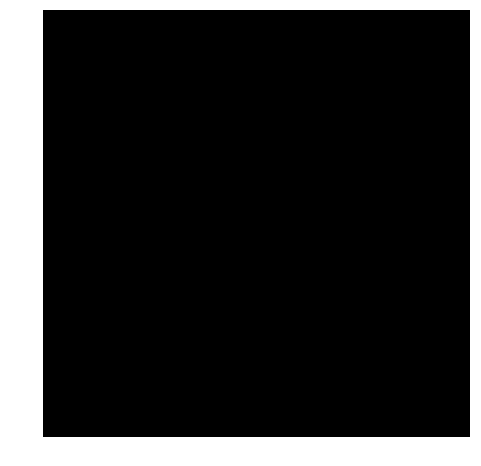

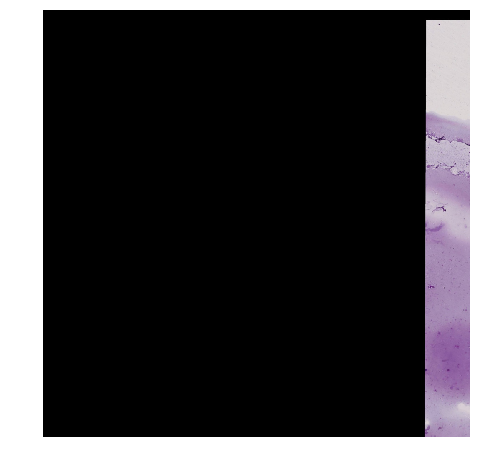

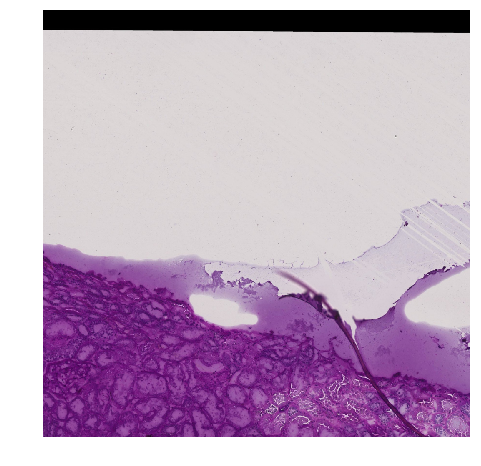

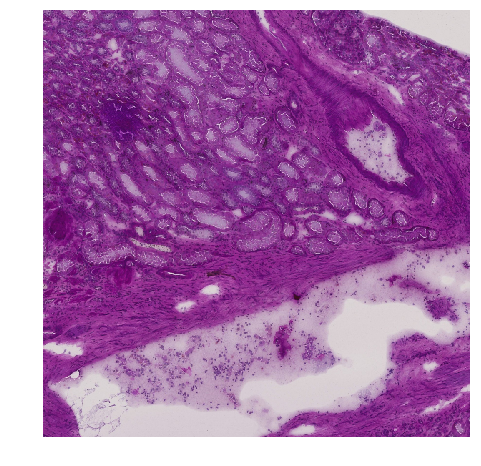

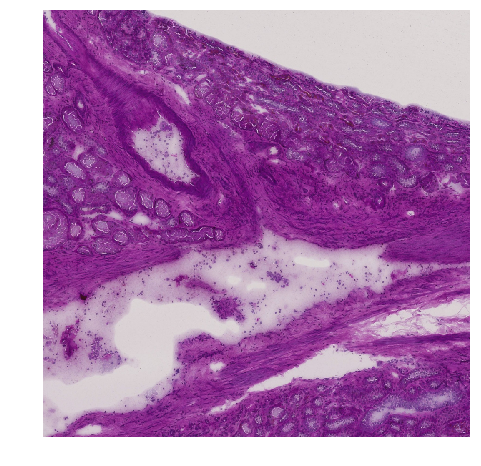

...

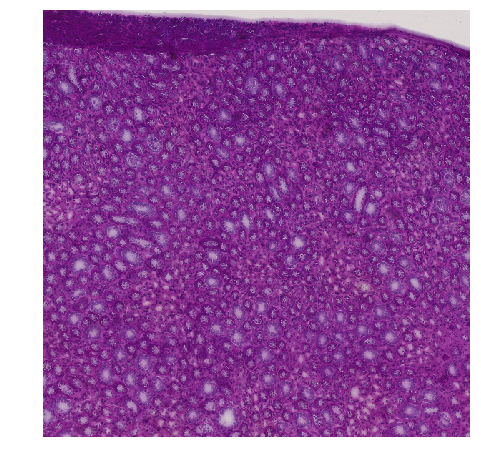

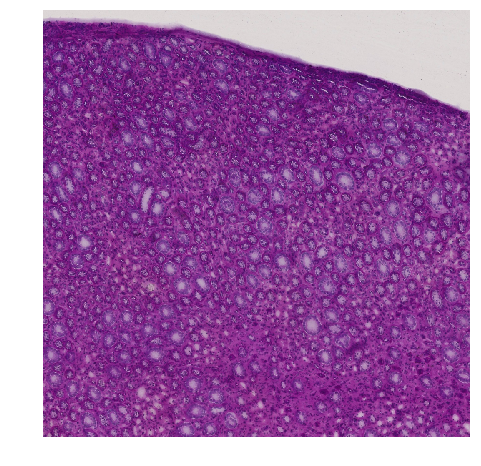

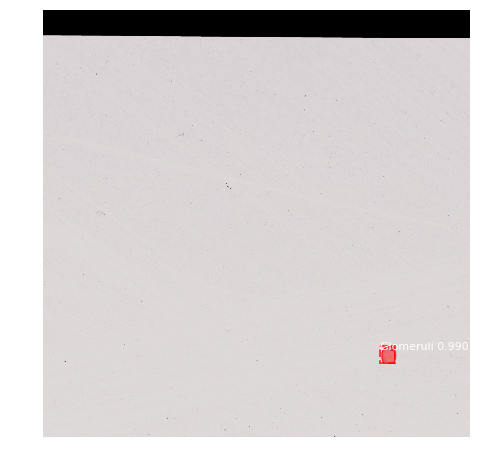

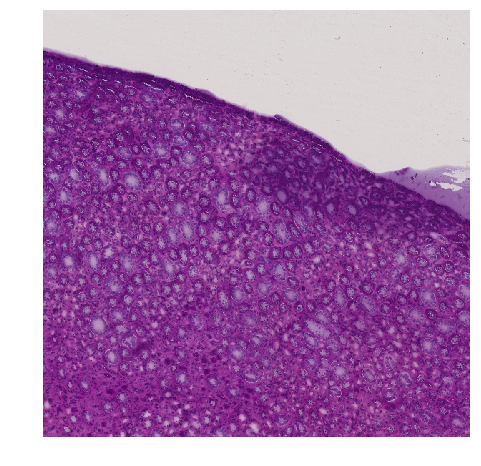

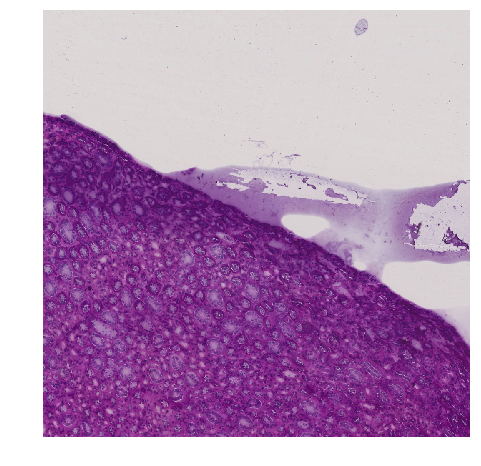

In [ ]:
c=0
n=0
for image_id in tqdm(dataset_val.image_ids):
    original_image, image_meta =modellib.load_image_gt2(dataset_val, inference_config,image_id)

    log("original_image", original_image)
    log("image_meta", image_meta)
    results = model.detect([original_image], verbose=1)

    r = results[0]
    image_with_mask=visualize.display_instances(original_image, r['rois'], r['masks'], r['class_ids'], 
                            dataset_val.class_names, r['scores'], ax=get_ax(),score_threshold=0.99)
    
    cv2.imwrite(PATH+'_maskresults/{}'.format(file_reference_id_name[image_id][1]),image_with_mask)
    c=c+len(r['rois'])
    tr=None
    
    indexes=[i for i,v in enumerate(r['scores']) if v > 0.99]
    
    if len(indexes)>0:
        
    
#     if r['masks'].shape[-1]>0:
        
#         indexes=[i for i,v in enumerate(r['scores']) if v > 0.99]
            
        abc=r['masks']*1
        abc=abc[:,:,indexes]    
        tr=np.max(abc,axis=2)
        tr=tr*255
#         Masks[n] = tr
        n+=r['masks'].shape[-1]
    else:
        tr=np.zeros((1024, 1024))
        ...
#         Masks[n] = np.zeros((1024, 1024))

    cv2.imwrite(PATH+'_results/{}'.format(file_reference_id_name[image_id][1]),tr)
    